<img style="float: right;" src="data/paris.png">

<h1>Parcours Ingénieur en Intelligence Artificielle</h1>      
<p>Project 2</p>

<h2>Analyse exploratoire des données</h2>
<h2>Participez à un concours sur la Smart City</h2>

<h3>Husain Khatba</h3>

_________

## Sommaire

### Table of Contents


* [1. Contexte et objectifs](#chapter1)

* [2. Mise en place de l’environnement de travail](#chapter2)

* [3. Présentation du jeu de données](#chapter3)

* [4. Démarche méthodologique d’analyses du jeu de données](#chapter4)

    * [4.1 Les doublons](#section_4_1)
    * [4.2 Suppression des variables inutiles](#section_4_2)
    * [4.3 Traiter les valeurs aberrantes ](#section_4_3)
    * [4.4 Faire des analyses univariées et tracer des représentations graphiques](#section_4_4)
    * [4.5 La corrélation entre les caractéristiques numériques](#section_4_5)
    * [4.6 Faire une analyse bivariée et tracer des représentations graphiques](#section_4_6)
    * [4.7 Zoom sur les variables qualitatives](#section_4_7)
    * [4.8 Analyse géographique](#section_4_8)
    
* [5. Synthèse de l'analyse de données](#chapter5)


<a class="anchor" id="chapter1"><h1>1. Contexte et objectifs</h1></a>

<a class="anchor" id="chapter2"><h1>2. Mise en place de l’environnement de travail</h1></a>

In [2]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from wordcloud import WordCloud

%matplotlib inline

In [3]:
pd.set_option('display.max_row', 111)
pd.set_option('display.max_column', 111)

<a class="anchor" id="chapter3"><h1>3. Présentation du jeu de données</h1></a>

In [4]:
df = pd.read_csv('data/p2-arbres-fr.csv', sep=';')

#### Description du jeu de données

In [5]:
df.head(5)

,id,type_emplacement,domanialite,arrondissement,complement_addresse,numero,lieu,id_emplacement,libelle_francais,genre,espece,variete,circonference_cm,hauteur_m,stade_developpement,remarquable,geo_point_2d_a,geo_point_2d_b
0,99874,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,19,Marronnier,Aesculus,hippocastanum,NaN,20,5,NaN,0.0,48.857620,2.320962
1,99875,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,20,If,Taxus,baccata,NaN,65,8,A,NaN,48.857656,2.321031
2,99876,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,21,If,Taxus,baccata,NaN,90,10,A,NaN,48.857705,2.321061
3,99877,Arbre,Jardin,PARIS 7E ARRDT,NaN,NaN,MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E,22,Erable,Acer,negundo,NaN,60,8,A,NaN,48.857722,2.321006
4,99878,Arbre,Jardin,PARIS 17E ARRDT,NaN,NaN,PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING,000G0037,Arbre à miel,Tetradium,daniellii,NaN,38,0,NaN,NaN,48.890435,2.315289


In [6]:
print("La forme des données est :", df.shape)

La forme des données est : (200137, 18)


In [7]:
df.describe(include=["object"])

,type_emplacement,domanialite,arrondissement,complement_addresse,lieu,id_emplacement,libelle_francais,genre,espece,variete,stade_developpement
count,200137,200136,200137,30902,200137,200137,198640,200121,198385,36777,132932
unique,1,9,25,3795,6921,69040,192,175,539,436,4
top,Arbre,Alignement,PARIS 15E ARRDT,SN°,PARC FLORAL DE PARIS / ROUTE DE LA PYRAMIDE,101001,Platane,Platanus,x hispanica,Baumannii',A
freq,200137,104949,17151,557,2995,1324,42508,42591,36409,4538,64438


In [8]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200137 entries, 0 to 200136
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   200137 non-null  int64  
 1   type_emplacement     200137 non-null  object 
 2   domanialite          200136 non-null  object 
 3   arrondissement       200137 non-null  object 
 4   complement_addresse  30902 non-null   object 
 5   numero               0 non-null       float64
 6   lieu                 200137 non-null  object 
 7   id_emplacement       200137 non-null  object 
 8   libelle_francais     198640 non-null  object 
 9   genre                200121 non-null  object 
 10  espece               198385 non-null  object 
 11  variete              36777 non-null   object 
 12  circonference_cm     200137 non-null  int64  
 13  hauteur_m            200137 non-null  int64  
 14  stade_developpement  132932 non-null  object 
 15  remarquable      

#### Classification des variables 

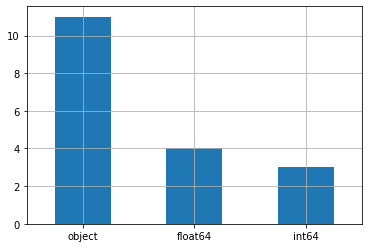

In [9]:
pd.DataFrame(df).dtypes.value_counts().plot(kind='bar', rot=0).grid()

<a class="anchor" id="chapter4"><h1>4. Démarche méthodologique d’analyses du jeu de données</h1></a>

<a class="anchor" id="section_4_1"><h3>4.1 Les doublons</h3></a>

In [10]:
df[df.id.duplicated()].shape

(0, 18)

Aucun id n'est dupliqué, on peut considérer que chaque ligne du jeu de données est unique

<a class="anchor" id="section_4_2"><h3>4.2 Suppression des variables inutiles</h3></a>

In [11]:
# Affichage des valeurs manquantes en %
(df.isna().sum()/df.shape[0]).sort_values(ascending=True) * 100

id                       0.000000
hauteur_m                0.000000
circonference_cm         0.000000
geo_point_2d_a           0.000000
id_emplacement           0.000000
lieu                     0.000000
geo_point_2d_b           0.000000
arrondissement           0.000000
type_emplacement         0.000000
domanialite              0.000500
genre                    0.007995
libelle_francais         0.747988
espece                   0.875400
remarquable             31.527404
stade_developpement     33.579498
variete                 81.624088
complement_addresse     84.559577
numero                 100.000000
dtype: float64

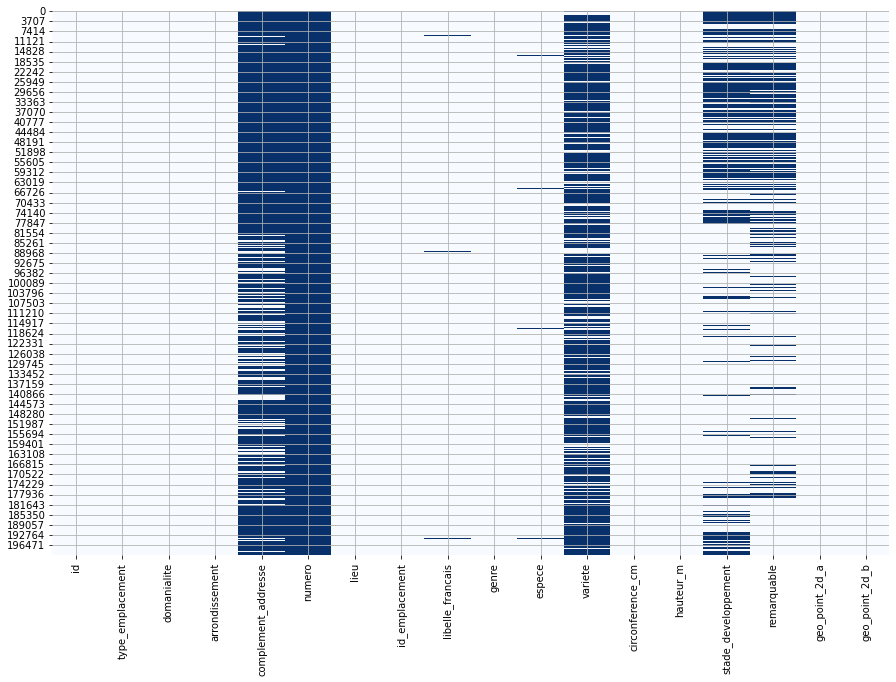

In [12]:
# Affichage des valeurs manquantes en "heatmap" avec la librarie seaborn

plt.figure(figsize=(15,10))
sns.heatmap(df.isna(), cmap="Blues", cbar=False).grid()
plt.show()

In [13]:
df.drop(['id', 'numero', 'type_emplacement', 'complement_addresse', 'id_emplacement', 'variete'], axis=1, inplace=True)

In [14]:
df.shape

(200137, 12)

<a class="anchor" id="section_4_3"><h3>4.3 Traiter les valeurs aberrantes </h3></a>

In [15]:
print(df["circonference_cm"].min())
print(df["circonference_cm"].max())
print(df["hauteur_m"].min())
print(df["hauteur_m"].max())

0
250255
0
881818


#### Boxplot la distribution des données quantitatives "circonference_cm", "hauteur_m"

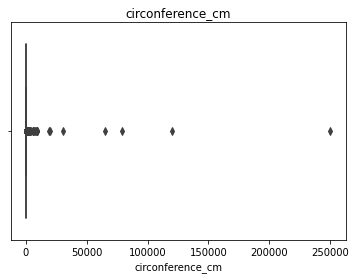

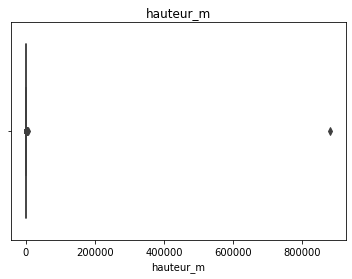

In [16]:
df_quanti = ["circonference_cm", "hauteur_m"]

for col in df[df_quanti]:
    plt.figure()
    sns.boxplot(x=df[col])
    plt.title(col)
    plt.show()

In [17]:
#Pour traiter les valeurs aberrantes nous allons identifier des outliers avec l'écart inter-quartiles

#L’écart interquartile est une mesure de dispersion qui s'obtient en faisant la différence entre le troisième et le premier quartile : EI = Q3 - Q1

#EI est un estimateur statistique robuste. 
#Q1 : 1er  quartile est la donnée de la série qui sépare les 25 % inférieurs des données 
#Q3 : 3eme quartile est la donnée de la série qui sépare les 75 % inférieurs des données

#Formule : EI = Q3 - Q1

Q1 = df[["circonference_cm", "hauteur_m"]].quantile(0.25)
Q3 = df[["circonference_cm", "hauteur_m"]].quantile(0.75)

EI = Q3 - Q1

EI

circonference_cm    85.0
hauteur_m            7.0
dtype: float64

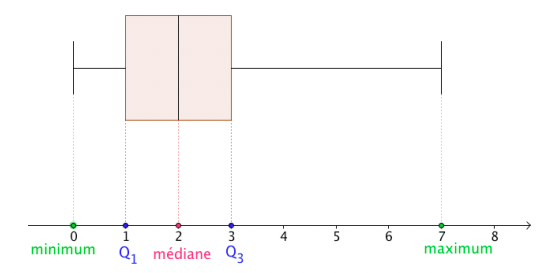

In [18]:
lower_limit = Q1 - 1.5*EI
upper_limit = Q3 + 1.5*EI

print(f"Limite supérieure : \n{upper_limit}\n\nLimite inférieure : \n{lower_limit}")

Limite supérieure : 
circonference_cm    242.5
hauteur_m            22.5
dtype: float64

Limite inférieure : 
circonference_cm   -97.5
hauteur_m           -5.5
dtype: float64


In [19]:
print(sum(df["circonference_cm"] == 0))
print(sum(df["hauteur_m"] == 0))
print(sum(df["hauteur_m"] == 0) & sum(df["circonference_cm"] == 0))

25867
39219
259


In [20]:
df_filtered = df[~((df[["hauteur_m", "circonference_cm"]] < lower_limit) | (df[["hauteur_m", "circonference_cm"]] > upper_limit)).any(axis=1)]

In [21]:
df_filtered.shape

(193997, 12)

#### Boxplot après suppression des valeurs aberrantes

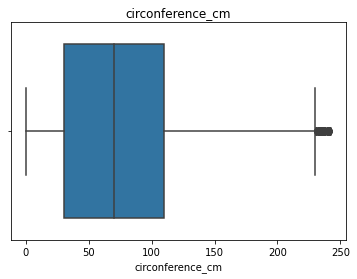

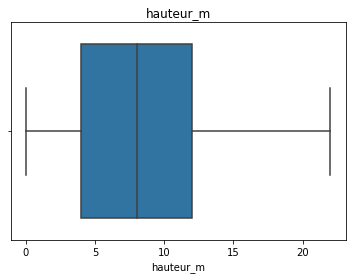

In [22]:
var_quanti = ["circonference_cm", "hauteur_m"]

for col in df[var_quanti]:
    
    plt.title(col)
    sns.boxplot(x=df_filtered[col])
    
    plt.show()

<a class="anchor" id="section_4_3"><h3>4.4 Faire des analyses univariées et tracer des représentations graphiques</h3></a>

Moyenne : 74.8cm , Médiane : 70.0cm , Écart type : 55.37cm


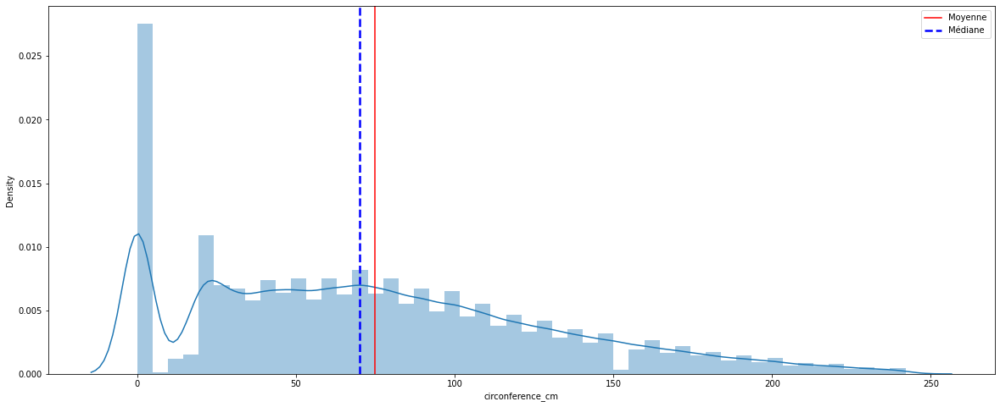

Moyenne : 7.93cm , Médiane : 8.0cm , Écart type : 5.7cm


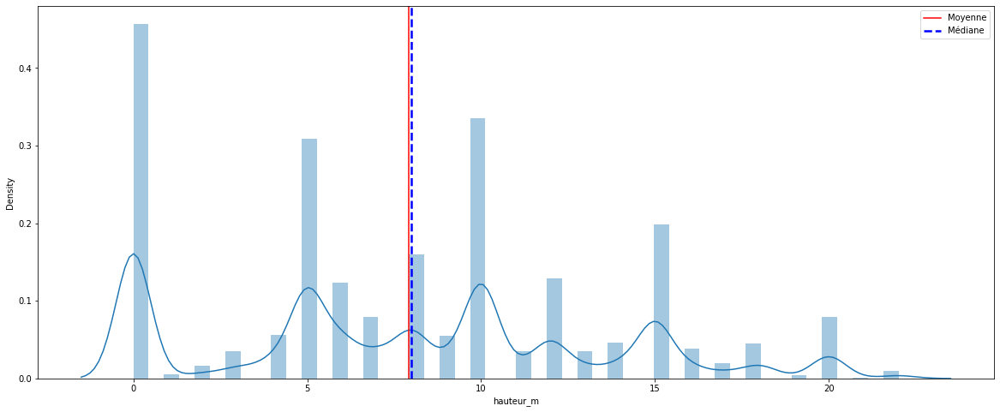

In [23]:
df_quanti = ["circonference_cm", "hauteur_m"]

for col in df[df_quanti]:

    mean   = round(df_filtered[col].mean(), 2)
    median = round(df_filtered[col].median(), 2)
    std    = round(df_filtered[col].std(), 2)
    
    print(f'Moyenne : {mean}cm ,', f'Médiane : {median}cm ,', f'Écart type : {std}cm')
    
    plt.figure(figsize=(20,8))
    sns.distplot(df_filtered[col])
    
    ## mean
    plt.axvline(x=df_filtered[col].mean(), color='red', label="Moyenne")

    ## median
    plt.axvline(x=df_filtered[col].median(), color='blue', ls='--', lw=2.5, label="Médiane")
    
    plt.legend()
    plt.show();

<a class="anchor" id="section_4_5"><h3>4.5 La corrélation entre les caractéristiques numériques</h3></a>

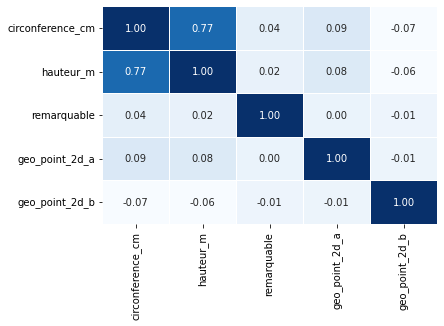

In [24]:
sns.heatmap(df_filtered.corr(), cmap="Blues", annot=True, fmt='.2f', linewidths=1, cbar=False)
plt.show()

<a class="anchor" id="section_4_5"><h3>4.6 Faire une analyse bivariée entre hauteur_m, circonference_cm et stade_developpement</h3></a>

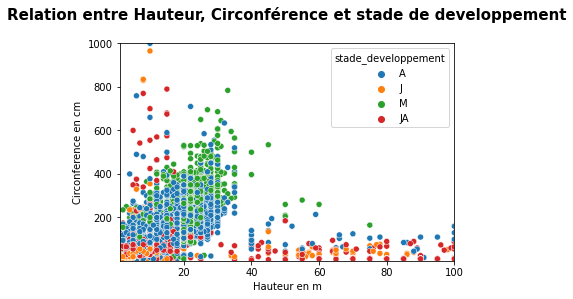

In [25]:
ax = sns.scatterplot(x='hauteur_m',
                     y='circonference_cm',
                     data=df,
                    hue="stade_developpement")
ax.set(xlim=(1, 100), ylim=(1, 1000))

plt.xlabel('Hauteur en m')
plt.ylabel('Circonference en cm')
plt.title('Relation entre Hauteur, Circonférence et stade de developpement\n', fontsize=15, fontweight='bold')
plt.show()

#### Histogramme des hauteurs

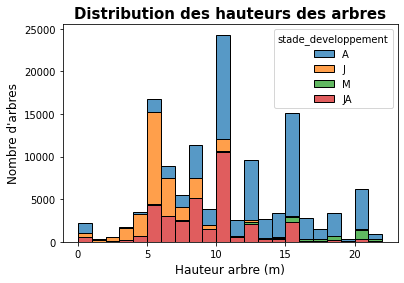

In [202]:
plt.figure()
sns.histplot(data=df_filtered, x='hauteur_m',hue='stade_developpement', multiple="stack", binwidth=1)
plt.title('Distribution des hauteurs des arbres', fontsize=15, fontweight='bold')
plt.xlabel('Hauteur arbre (m)', fontsize=12)
plt.ylabel('Nombre d\'arbres', fontsize=12) 
plt.show()

#### Histogramme des circonferences

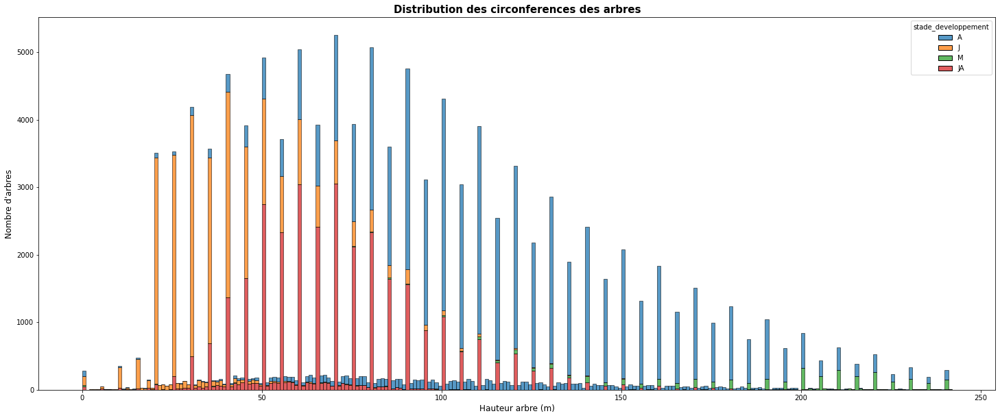

In [203]:
plt.figure(figsize=(25,10))
sns.histplot(data=df_filtered, x='circonference_cm',hue='stade_developpement', multiple="stack",binwidth=1)
plt.title('Distribution des circonferences des arbres', fontsize=15, fontweight='bold')
plt.xlabel('Hauteur arbre (m)', fontsize=12)
plt.ylabel('Nombre d\'arbres', fontsize=12) 
plt.show()

#### Boxplot des arbres pour hauteur_m, circonference_cm et stade_developpement

<AxesSubplot:title={'center':'Circonférence par stade de développement'}, xlabel='stade_developpement', ylabel='circonference_cm'>

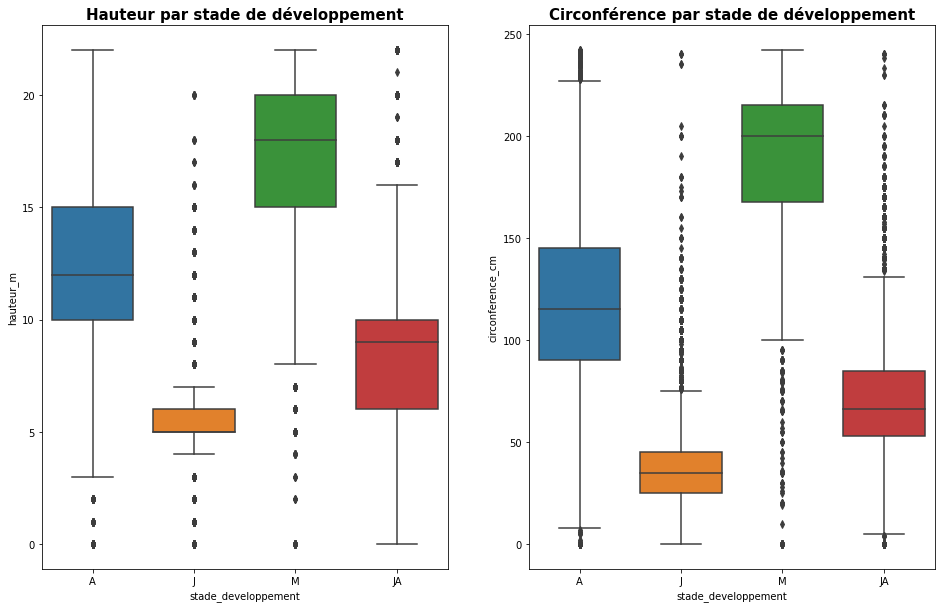

In [26]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16,10))

ax1.set_title("Hauteur par stade de développement", fontsize=15, fontweight='bold')
ax2.set_title("Circonférence par stade de développement", fontsize=15, fontweight='bold')

sns.boxplot(data=df_filtered, x="stade_developpement", y="hauteur_m", order=['A', 'J', 'M', 'JA'], ax=ax1)
sns.boxplot(data=df_filtered, x="stade_developpement", y="circonference_cm", order=['A', 'J', 'M', 'JA'], ax=ax2)

<a class="anchor" id="section_4_7"><h3>4.7 Zoom sur les variables qualitatives</h3></a>

#### Word Cloud 

In [205]:
quali = ["domanialite", "arrondissement", "stade_developpement", "lieu", "libelle_francais", "genre", "espece"]

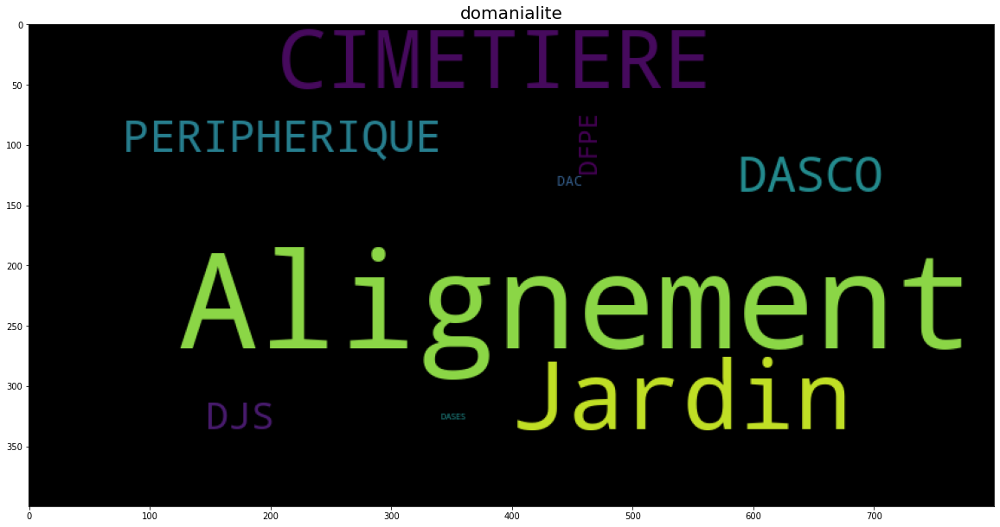

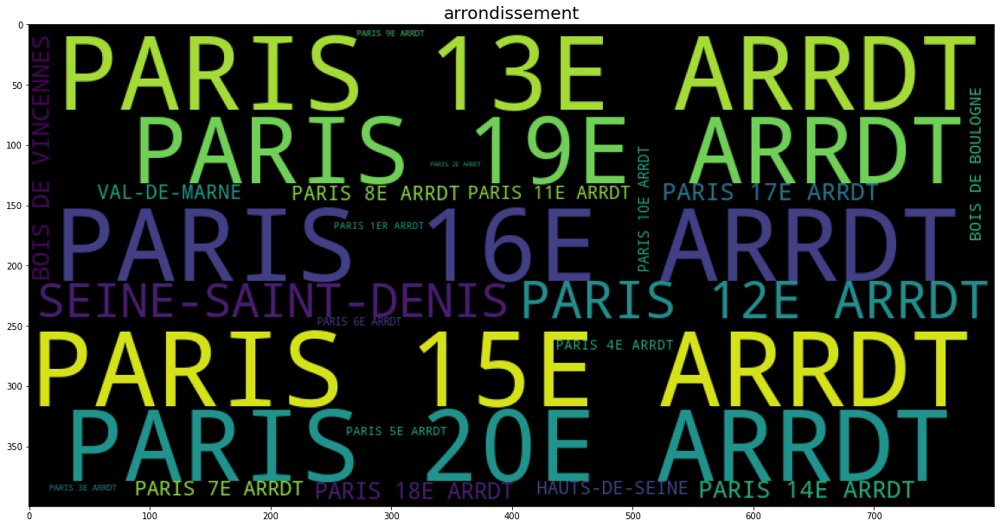

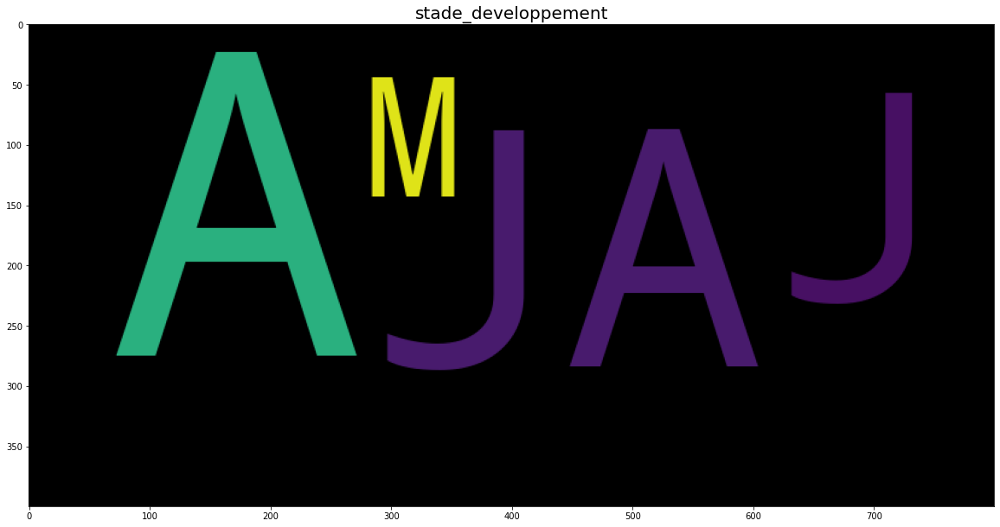

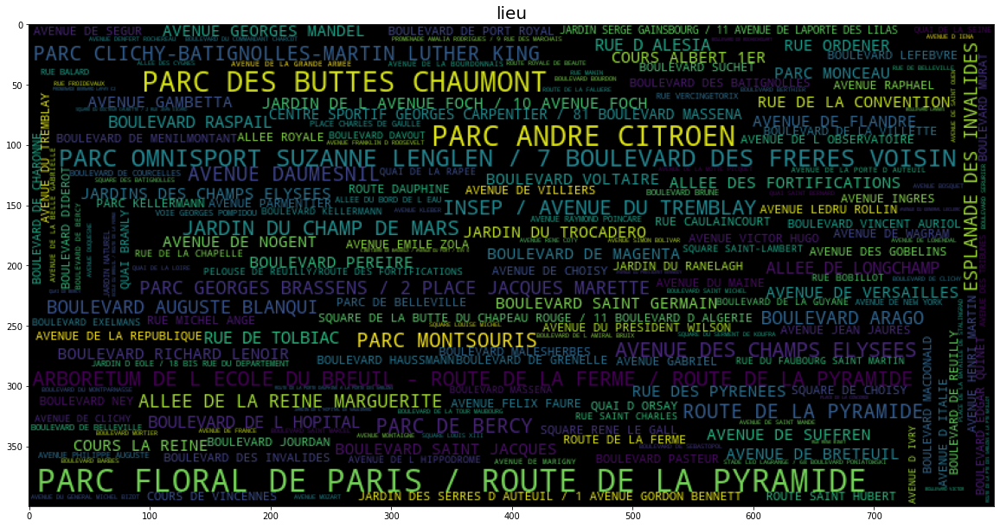

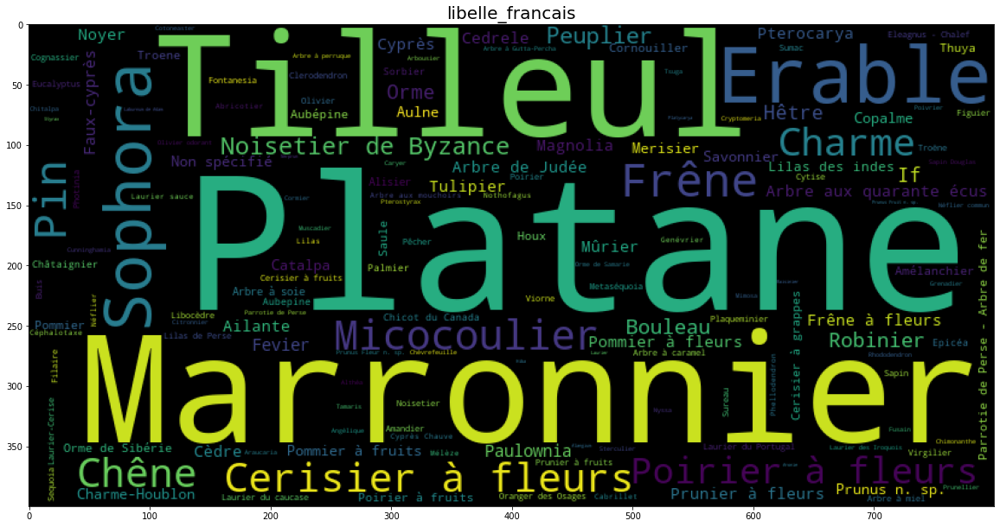

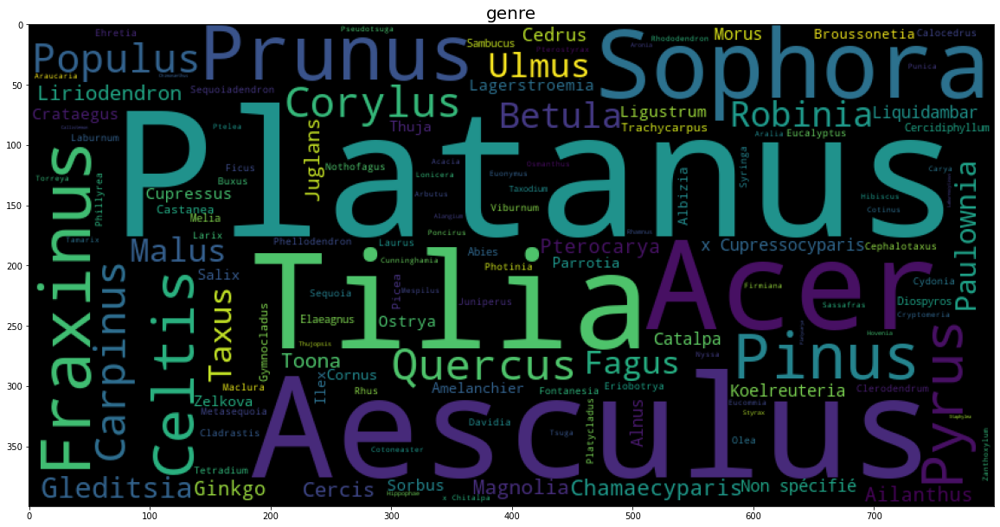

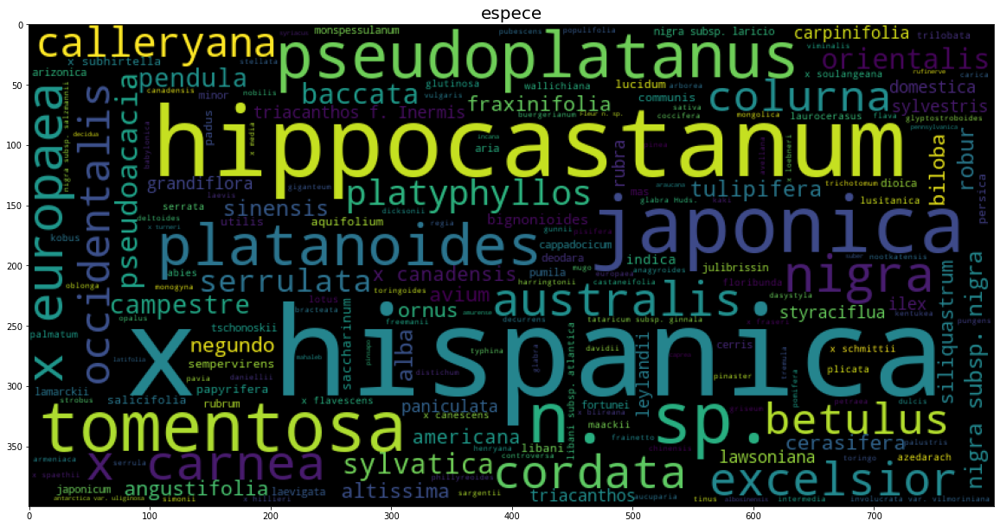

In [206]:
for q in quali:
    
    var_occurences = df_filtered[q].value_counts()

    wordcloud = WordCloud(width=800, height=400).generate_from_frequencies(var_occurences)

    plt.figure(figsize=(20,15))

    plt.title(q, fontsize=20)

    plt.imshow(wordcloud)

#### Les valeurs uniques de chaque variable

In [207]:
for col in quali:
    print(f'{col}\n{df[col].unique()}', end='\n\n\n')

domanialite
['Jardin' 'Alignement' 'DJS' 'DFPE' 'CIMETIERE' 'DASCO' 'DAC'
 'PERIPHERIQUE' 'DASES' nan]


arrondissement
['PARIS 7E ARRDT' 'PARIS 17E ARRDT' 'PARIS 16E ARRDT' 'PARIS 4E ARRDT'
 'PARIS 13E ARRDT' 'PARIS 12E ARRDT' 'PARIS 19E ARRDT' 'PARIS 14E ARRDT'
 'PARIS 15E ARRDT' 'PARIS 3E ARRDT' 'PARIS 20E ARRDT' 'PARIS 18E ARRDT'
 'PARIS 6E ARRDT' 'PARIS 11E ARRDT' 'PARIS 1ER ARRDT' 'PARIS 2E ARRDT'
 'PARIS 5E ARRDT' 'VAL-DE-MARNE' 'SEINE-SAINT-DENIS' 'HAUTS-DE-SEINE'
 'PARIS 9E ARRDT' 'PARIS 10E ARRDT' 'PARIS 8E ARRDT' 'BOIS DE BOULOGNE'
 'BOIS DE VINCENNES']


stade_developpement
[nan 'A' 'J' 'M' 'JA']


lieu
['MAIRIE DU 7E 116 RUE DE GRENELLE PARIS 7E'
 'PARC CLICHY-BATIGNOLLES-MARTIN LUTHER KING'
 'SQUARE ALEXANDRE ET RENE PARODI / 1 PLACE DE LA PORTE MAILLOT' ...
 'TERRAIN D EDUCATION PHYSIQUE / 49 RUE OLIVIER METRA' 'RUE EDOUARD QUENU'
 'RUE DU GENERAL NIESSEL']


libelle_francais
['Marronnier' 'If' 'Erable' 'Arbre à miel' 'Platane' 'Sophora'
 'Prunus n. sp.' 'Hêtre' 'Micocou

In [208]:
#### Barplot des variables qualitatives

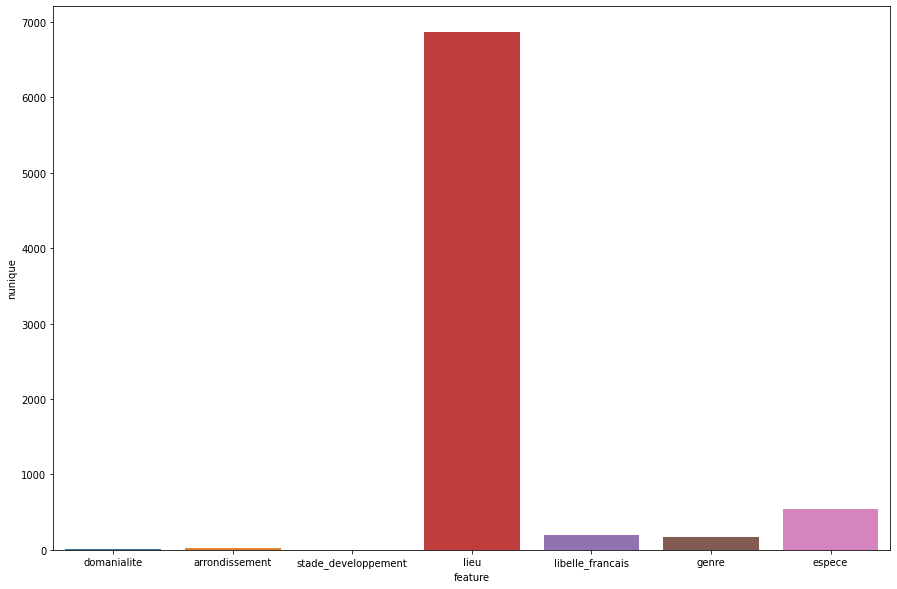

In [209]:
nu = df_filtered[quali].nunique().reset_index()
nu.columns = ['feature','nunique']
plt.figure(figsize=(15,10))
sns.barplot(x='feature', y='nunique', data=nu)
plt.show()

#### Répartition des stades de développement

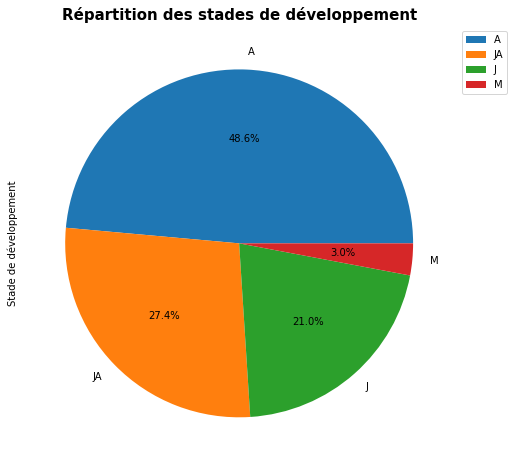

In [27]:
group_name=["A","JA", "J", "M"]
df_filtered.stade_developpement.value_counts().plot.pie(figsize=(10, 8), autopct='%1.1f%%', label="Stade de développement")
plt.title("Répartition des stades de développement", fontsize=15, fontweight='bold')
plt.legend(labels=group_name,bbox_to_anchor=(1, 1))
plt.show()

#### Nombre d'arbres par arrondissement

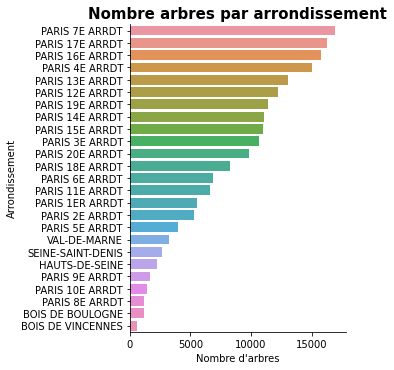

In [28]:
arbrepararrondissement = df_filtered['arrondissement'].value_counts().tolist()
arrondissements = df_filtered['arrondissement'].unique().tolist()
listStadeDev = ['A', 'J', 'M', 'JA']

sns.catplot(data=df_filtered, kind="bar", x=arbrepararrondissement, y=arrondissements)
plt.title('Nombre arbres par arrondissement', fontsize=15, fontweight='bold')
plt.xlabel('Nombre d\'arbres')
plt.ylabel('Arrondissement')
plt.show()

<br>

<a class="anchor" id="section_4_8"><h3>4.8 Analyse géographique</h3></a>

In [214]:
## Nous pouvons utiliser les données GPS pour tracer la position des arbes

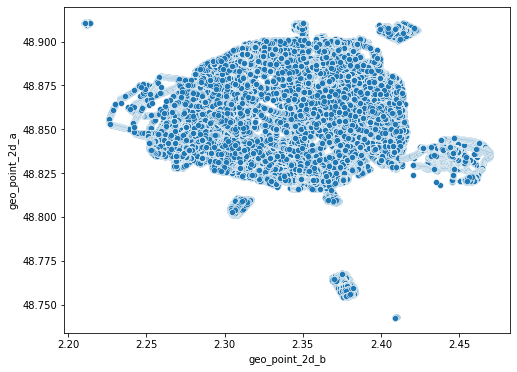

In [217]:
plt.figure(figsize=(8,6))
sns.scatterplot(data=df, x="geo_point_2d_b", y="geo_point_2d_a")
plt.show()

In [218]:
## Nous pouvons aussi utiliser folium pour tracer la position des arbes sur la carte de Paris

In [29]:
import folium

paris_map = folium.Map(location=[48.85, 2.35], )


for ind, lat, lon, com in df_filtered[['geo_point_2d_a', 'geo_point_2d_b', 'lieu']][:10000].itertuples():
    
    paris_map.add_child(folium.RegularPolygonMarker(location=[lat,lon], popup=com, fill_color='green', radius=5))
    
paris_map

<a class="anchor" id="chapter5"><h1>5. Synthèse de l'analyse de données</h1></a>